# Experiments

Transfer Learning


In [2]:
from data import mask_to_submission
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np
from skimage import color
import os
import seaborn as sns
import pandas as pd

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset, SubsetRandomSampler, random_split
import albumentations as album
%matplotlib inline

from scripts.preprocessing import *
from scripts.evaluation import *

DEVICE = "mps" if getattr(torch, "has_mps", False) else "cpu"
print(DEVICE)
from scripts.models import *
from scripts.training import *
#masa_info = pd.read_csv('data/derivatives/masachussetts_info.csv')

import torch
import torchvision
from torchvision import models
from torch import nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import os
from PIL import Image

def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def human_readable(num):
    magnitude = 0
    while abs(num) >= 1000:
        magnitude += 1
        num /= 1000.0
    return '{:.2f}{}'.format(num, ['', 'K', 'M', 'B', 'T'][magnitude])

def test_masks(test_directory, model, visualize_number=6, deep=False, viz_all = False):

  test_filepaths = []
  for root, dirs, files in sorted(os.walk(test_directory))[1:]: test_filepaths.append(root+'/'+files[0])

  model.eval()

  output_masks = [] #Here we go baby
  output_masks_filenames = []
  for fdx, file in enumerate(sorted(test_filepaths)):

    test_img = cv.imread(file)
    test_img = torch.tensor(test_img[:,:,:,None].T, dtype=torch.float32).to(device=DEVICE)

    if (not deep):
      mask = np.where(identity_detach(model(test_img)) > 0.5, 1, 0)[0][0]
    else:
      #print(test_img.shape)
      mask = np.where(identity_detach(model(test_img)['out'])>0.5, 1, 0)[0][0]

    if (fdx%5 == 0): print(f"data/test_masks/{file.split('/')[-1]}")
    output_filename = f"data/test_masks/{file.split('/')[-1]}"
    output_masks_filenames.append(output_filename)
    cv.imwrite(output_filename, 255*mask.T)

    output_masks.append(mask.T)

  test_ids =  np.random.choice(len(output_masks), size = visualize_number)
  if (not viz_all):
    for i in range(visualize_number):
      plt.figure(figsize = (3, 3))
      test_img = cv.imread(test_filepaths[test_ids[i]])
      out_img = color.gray2rgb(255*output_masks[test_ids[i]])
      #print(test_img, out_img)
      cat_img = np.concatenate([test_img, out_img], axis=1)
      plt.imshow(cat_img)
      plt.show()
  if (viz_all):
    for i in range(17):
      fig, ax = plt.subplots(1, 3, figsize = (9, 3))
      num_im = 3
      if (i==16):
         num_im = 2
      for j in range(num_im):
        test_img = cv.imread(test_filepaths[i*3 + j])
        out_img = color.gray2rgb(255*output_masks[i*3+j])
        cat_img = np.concatenate([test_img, out_img], axis=1)
        ax[j].imshow(cat_img)
      plt.tight_layout()
      plt.show()

  return output_masks, output_masks_filenames

mps


In [6]:
training_imgs_augmented = np.load('data/derivatives/training_images_daphne.npy')
training_labels_augmented = np.load('data/derivatives/training_images_daphne_labels.npy')

training_imgs_ottab = np.load('data/derivatives/training_images_otta_3.npy')
training_labels_ottab = np.load('data/derivatives/training_images_otta_3_labels.npy')

training_imgs = np.concatenate([training_imgs_ottab, training_imgs_augmented], axis = 0)
training_labels = np.concatenate([training_labels_ottab, training_labels_augmented], axis = 0)

X = training_imgs
y = training_labels
print(X.shape, y.shape)

(600, 400, 400, 3) (600, 400, 400, 1)


In [8]:
X_train, X_validation, y_train, y_validation = train_test_split(X, y, test_size=.01, shuffle=True)

batch_size = 5
train_dataset = TensorDataset(torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32))
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, pin_memory=torch.cuda.is_available(),
                              drop_last = True, num_workers = 2) #create train data loader

validation_dataset = TensorDataset(torch.tensor(X_validation, dtype=torch.float32), torch.tensor(y_validation, dtype=torch.float32))
validation_loader = DataLoader(validation_dataset, batch_size=batch_size) #create


def create_deeplabv3(outputchannels=1):
    model = models.segmentation.deeplabv3_resnet50(pretrained=True)
    model.classifier[4] = nn.Conv2d(256, outputchannels, kernel_size=(1,1), stride=(1,1))
    return model

In [9]:
#deeplab = create_deeplabv3().to(DEVICE)

/Users/leger/Library/Python/3.9/lib/python/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/leger/Library/Python/3.9/lib/python/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [17]:
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.AdamW(deeplab.parameters(), lr=7*1e-7)

num_epochs = 10
for epoch in range(num_epochs):
    deeplab.train()
    for bdx, (images, masks) in enumerate(train_loader):
        
        #if (epoch==0): print(round(bdx/len(train_loader), 2))
        images, masks = images.to(DEVICE), masks.to(DEVICE)
        images, masks = permutate_labels(images), permutate_labels(masks)

        optimizer.zero_grad()
        output = deeplab(images)['out']

        loss = criterion(output, masks)
        loss.backward()
        optimizer.step()
    print(f"Epoch {epoch+1}, Loss: {loss.item()}")

Epoch 1, Loss: 0.05966012552380562
Epoch 2, Loss: 0.034806977957487106
Epoch 3, Loss: 0.04605628177523613
Epoch 4, Loss: 0.04890022799372673
Epoch 5, Loss: 0.04475298896431923
Epoch 6, Loss: 0.044105976819992065
Epoch 7, Loss: 0.05052175745368004
Epoch 8, Loss: 0.054709989577531815
Epoch 9, Loss: 0.040684837847948074
Epoch 10, Loss: 0.03696858510375023


In [18]:
deeplab.eval() 

DeepLabV3(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Se

In [19]:
torch.save(deeplab, "models/deeplab_best_40.pth")

data/test_masks/test_1.png
data/test_masks/test_14.png
data/test_masks/test_19.png
data/test_masks/test_23.png
data/test_masks/test_28.png
data/test_masks/test_32.png
data/test_masks/test_37.png
data/test_masks/test_41.png
data/test_masks/test_46.png
data/test_masks/test_50.png


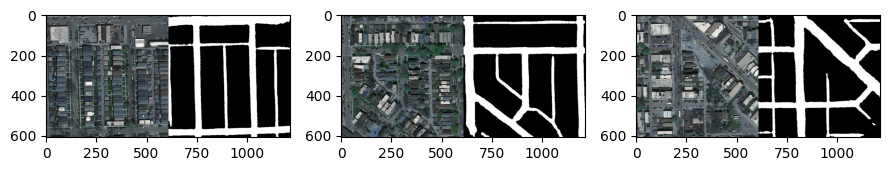

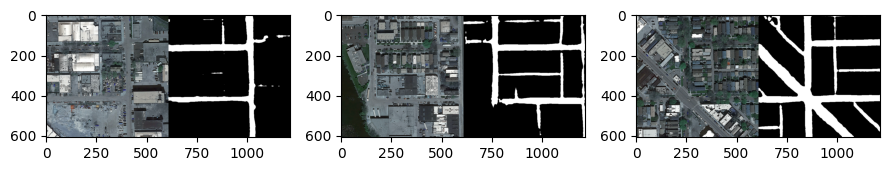

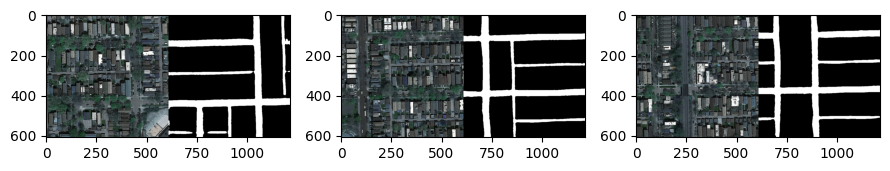

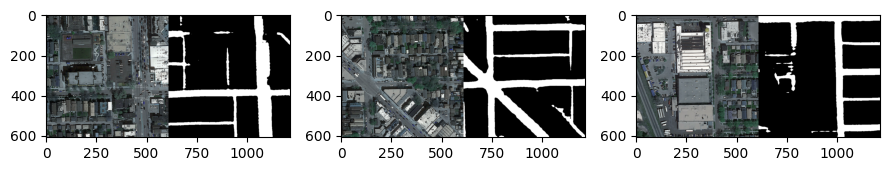

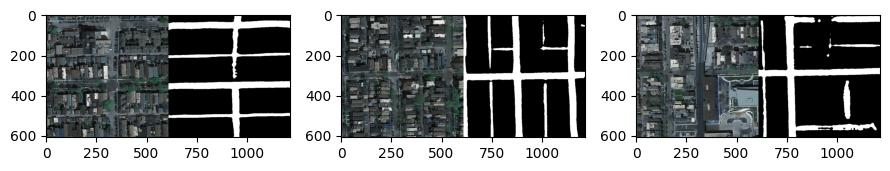

...

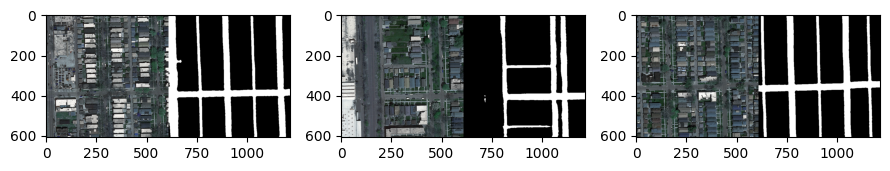

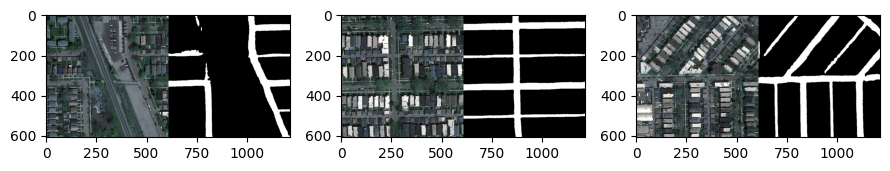

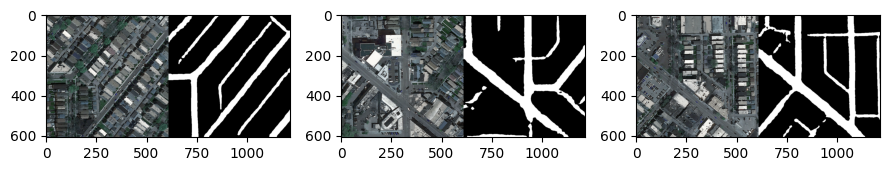

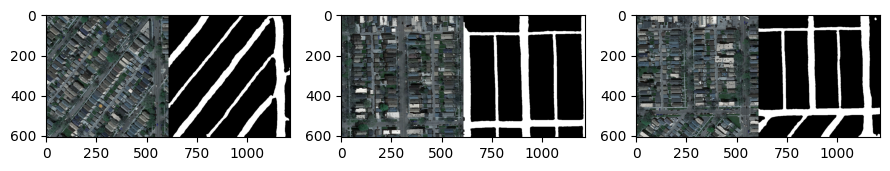

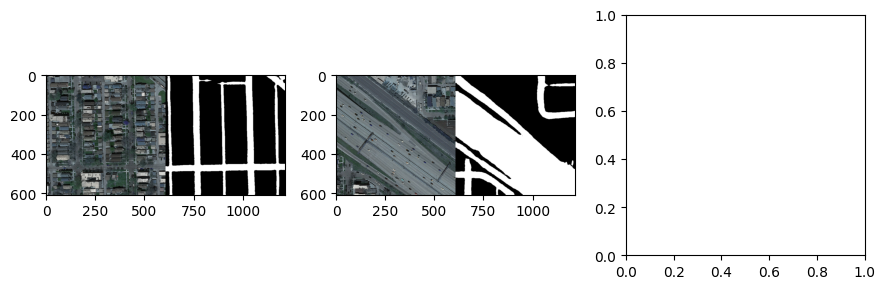

In [15]:
test_directory = "data/test_set_images/"
predicted_test_masks, mask_filenames = test_masks(test_directory, model = deeplab,
                                                  visualize_number=20, deep=True, viz_all=True)

In [16]:
mask_to_submission.masks_to_submission("submissions/sub_deeplab_best.csv", *mask_filenames)

## .2

data/test_masks/test_1.png
data/test_masks/test_14.png
data/test_masks/test_19.png
data/test_masks/test_23.png
data/test_masks/test_28.png
data/test_masks/test_32.png
data/test_masks/test_37.png
data/test_masks/test_41.png
data/test_masks/test_46.png
data/test_masks/test_50.png


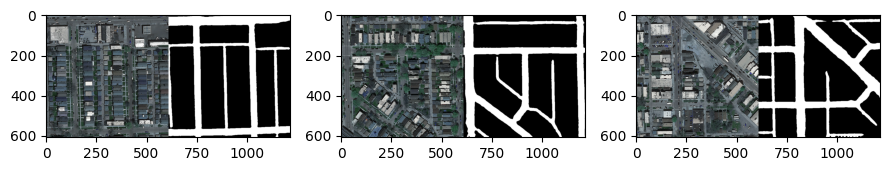

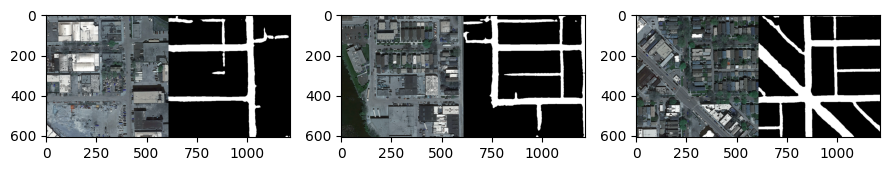

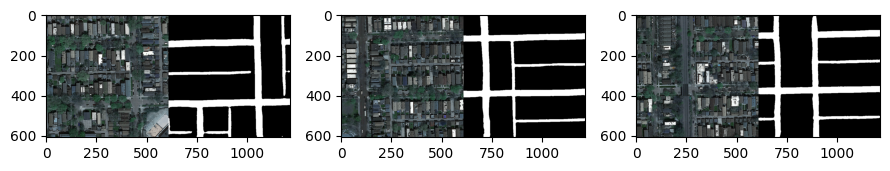

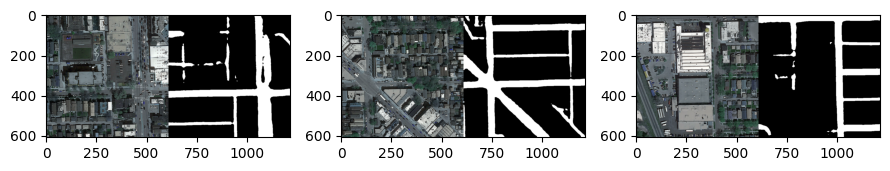

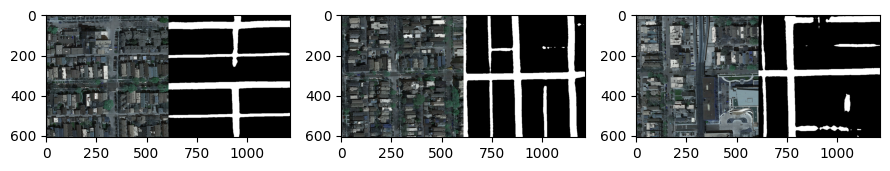

...

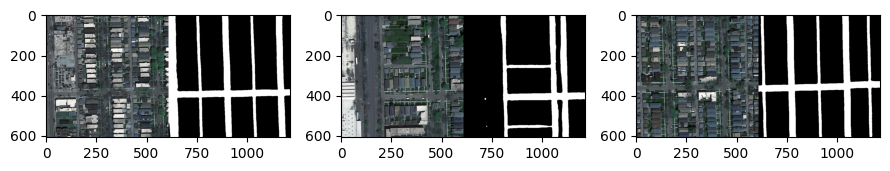

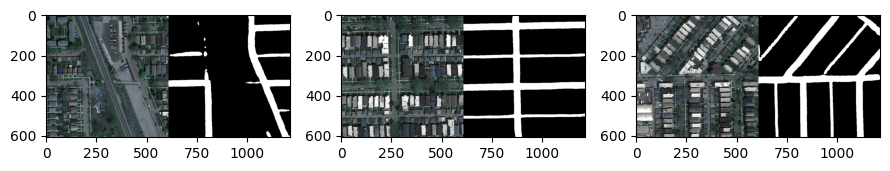

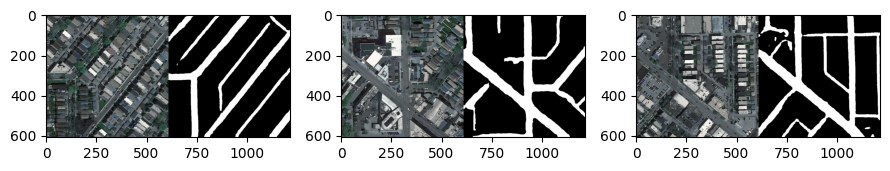

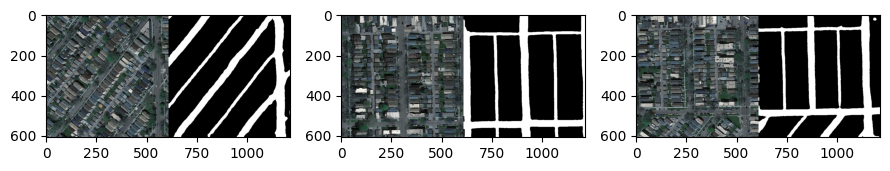

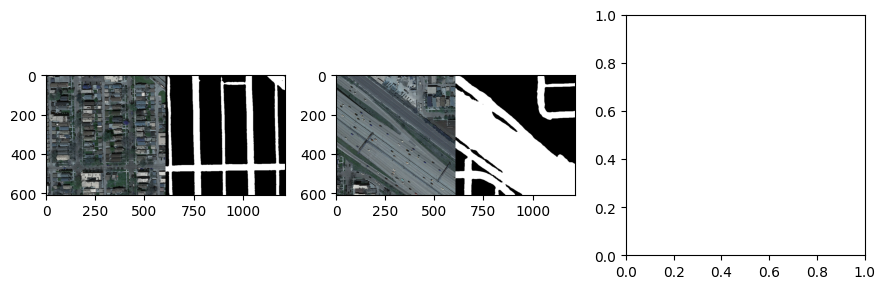

In [29]:
test_directory = "data/test_set_images/"
predicted_test_masks, mask_filenames = test_masks(test_directory, model = deeplab,
                                                  visualize_number=20, deep=True, viz_all=True)

## 2.4 

data/test_masks/test_1.png
data/test_masks/test_14.png
data/test_masks/test_19.png
data/test_masks/test_23.png
data/test_masks/test_28.png
data/test_masks/test_32.png
data/test_masks/test_37.png
data/test_masks/test_41.png
data/test_masks/test_46.png
data/test_masks/test_50.png


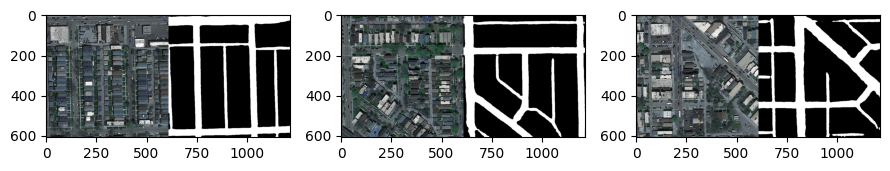

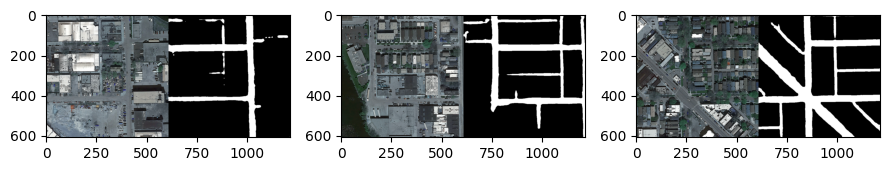

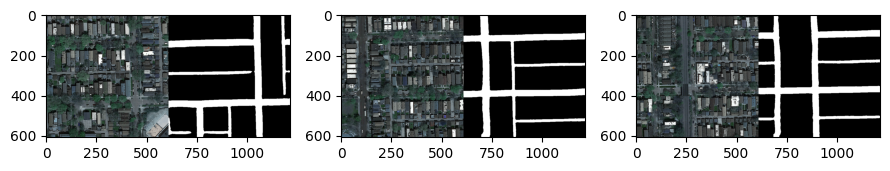

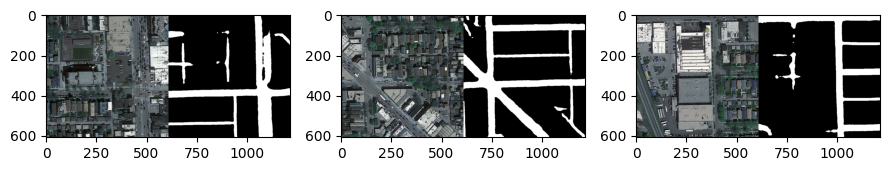

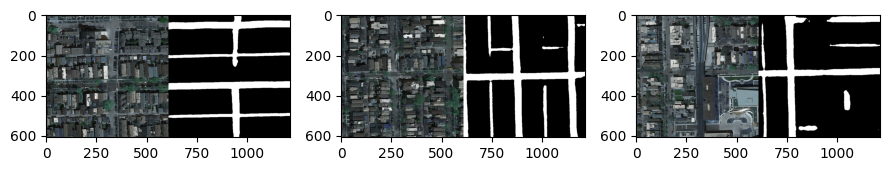

...

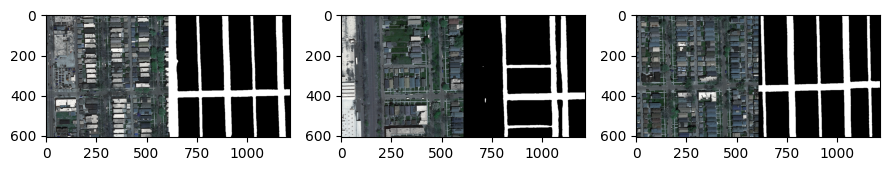

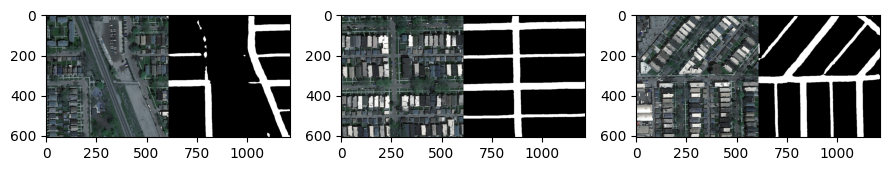

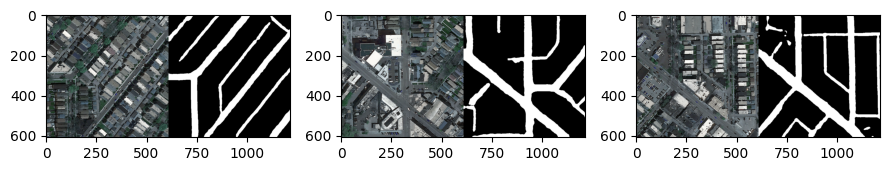

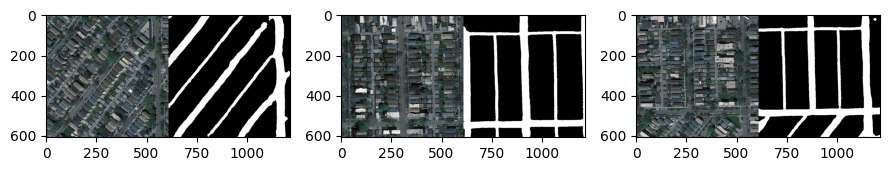

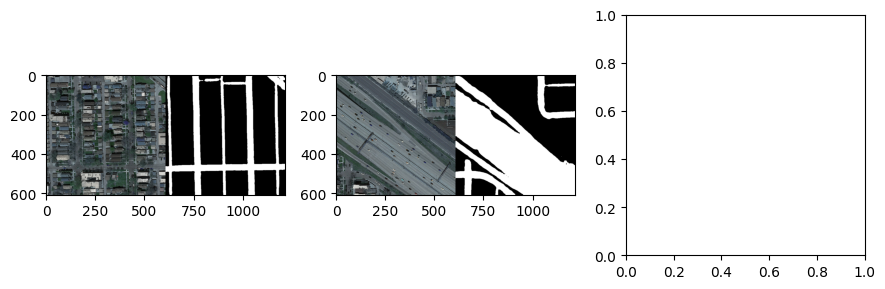

In [35]:
test_directory = "data/test_set_images/"
predicted_test_masks, mask_filenames = test_masks(test_directory, model = deeplab,
                                                  visualize_number=20, deep=True, viz_all=True)

## 2.5

data/test_masks/test_1.png
data/test_masks/test_14.png
data/test_masks/test_19.png
data/test_masks/test_23.png
data/test_masks/test_28.png
data/test_masks/test_32.png
data/test_masks/test_37.png
data/test_masks/test_41.png
data/test_masks/test_46.png
data/test_masks/test_50.png


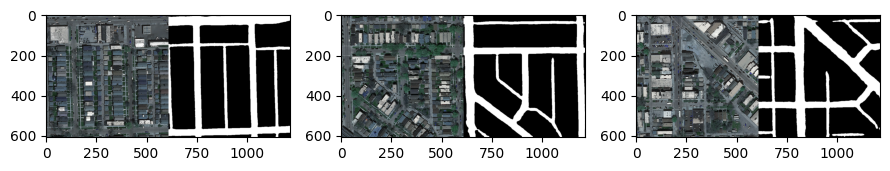

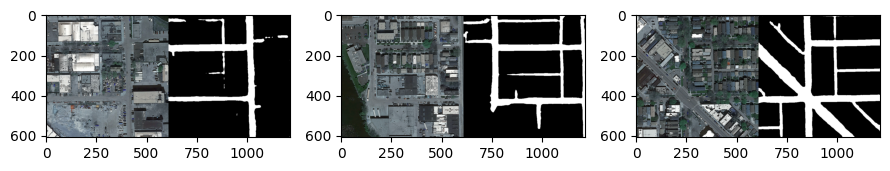

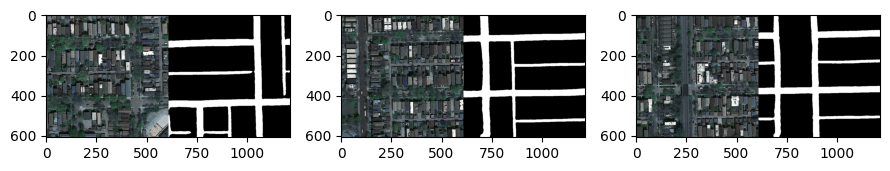

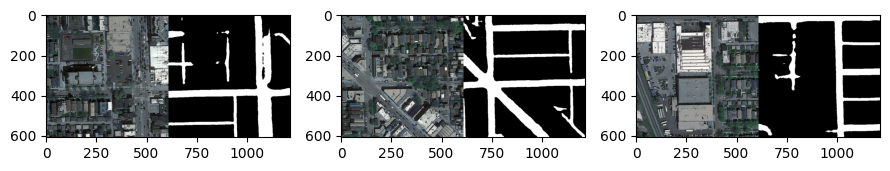

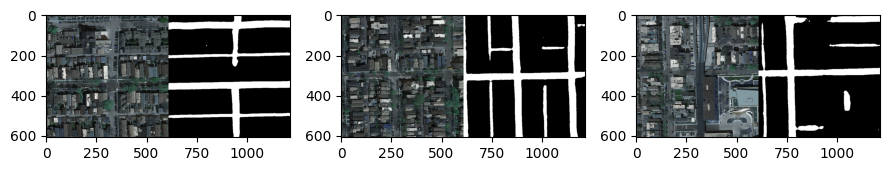

...

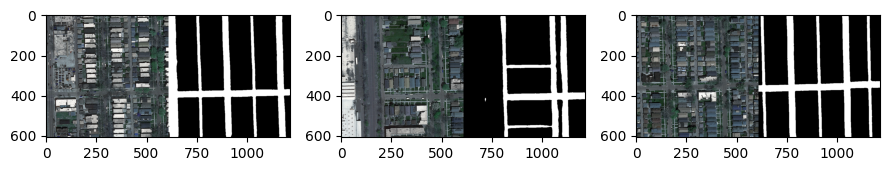

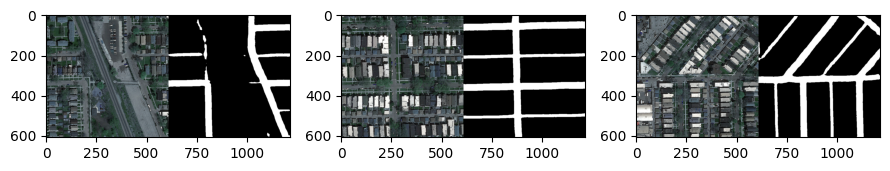

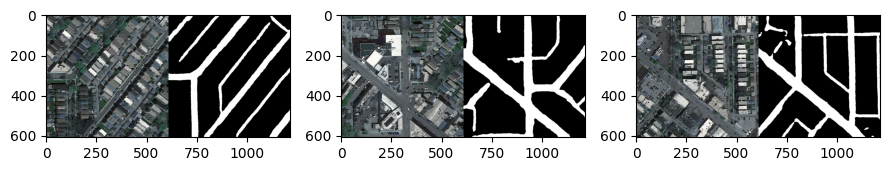

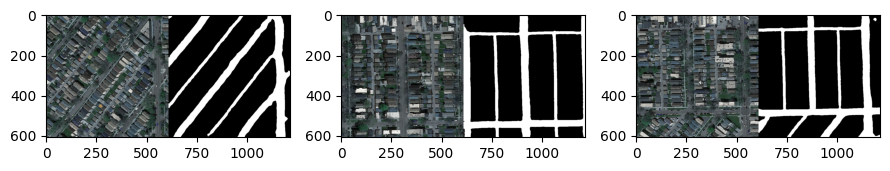

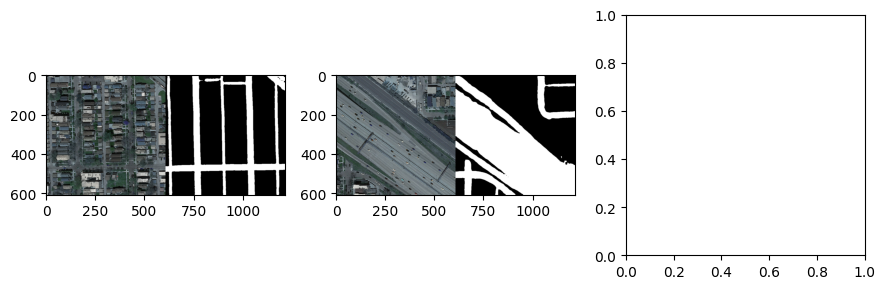

In [37]:
test_directory = "data/test_set_images/"
predicted_test_masks, mask_filenames = test_masks(test_directory, model = deeplab,
                                                  visualize_number=20, deep=True, viz_all=True)

## 2.6

#thing

data/test_masks/test_1.png
data/test_masks/test_14.png
data/test_masks/test_19.png
data/test_masks/test_23.png
data/test_masks/test_28.png
data/test_masks/test_32.png
data/test_masks/test_37.png
data/test_masks/test_41.png
data/test_masks/test_46.png
data/test_masks/test_50.png


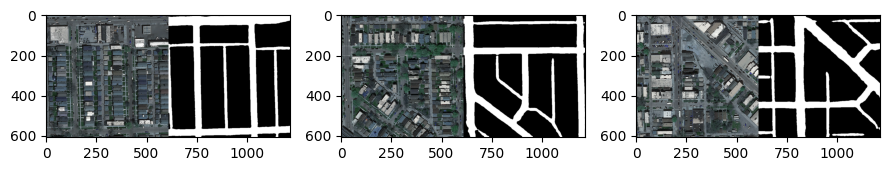

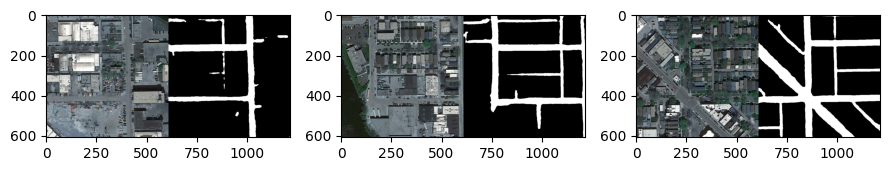

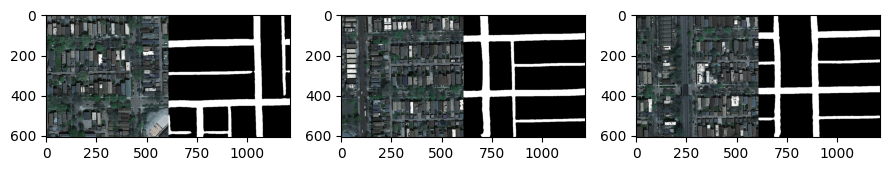

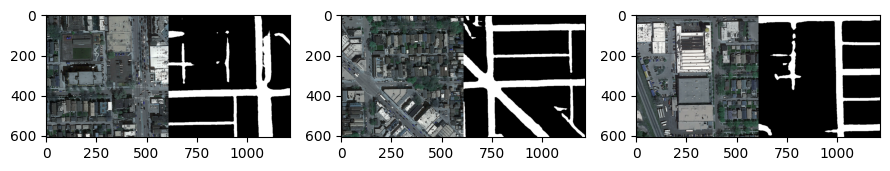

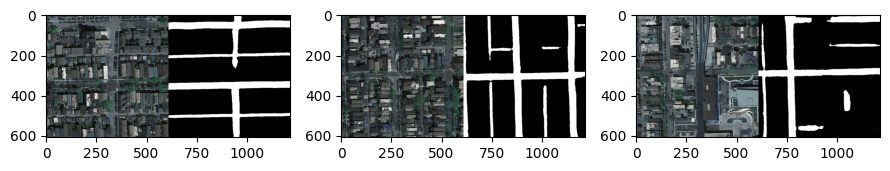

...

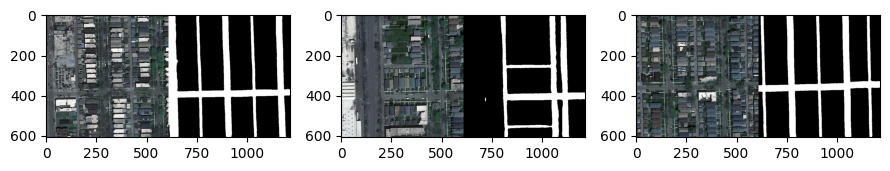

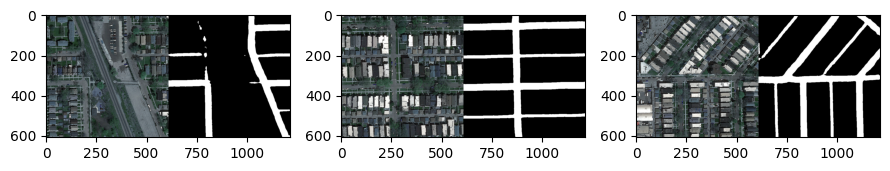

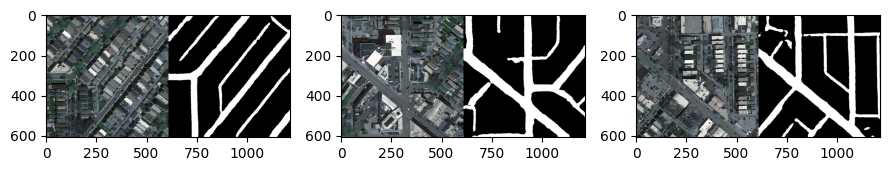

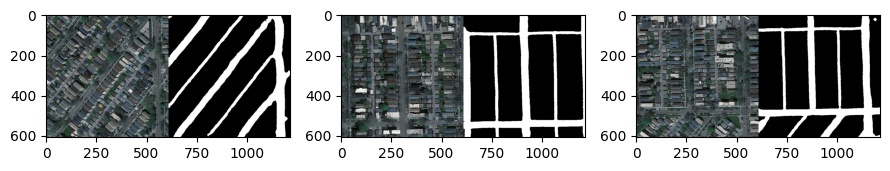

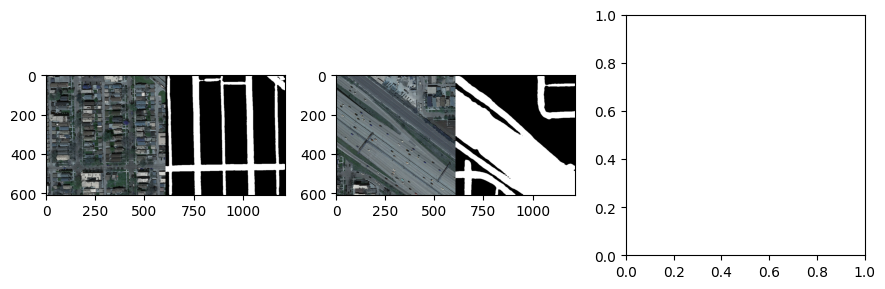

In [46]:
test_directory = "data/test_set_images/"
predicted_test_masks, mask_filenames = test_masks(test_directory, model = deeplab,
                                                  visualize_number=20, deep=True, viz_all=True)

## 2.7

data/test_masks/test_1.png
data/test_masks/test_14.png
data/test_masks/test_19.png
data/test_masks/test_23.png
data/test_masks/test_28.png
data/test_masks/test_32.png
data/test_masks/test_37.png
data/test_masks/test_41.png
data/test_masks/test_46.png
data/test_masks/test_50.png


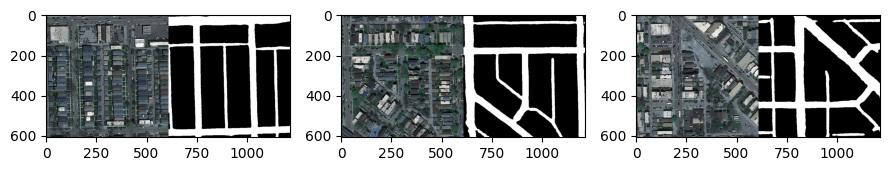

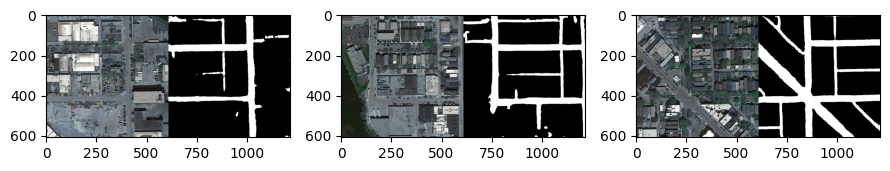

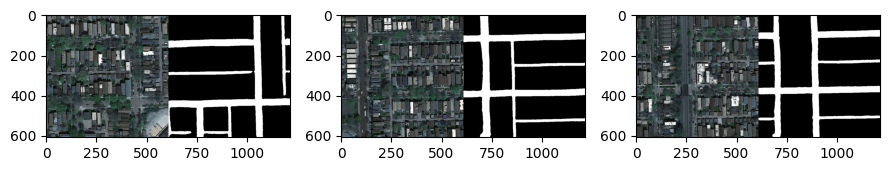

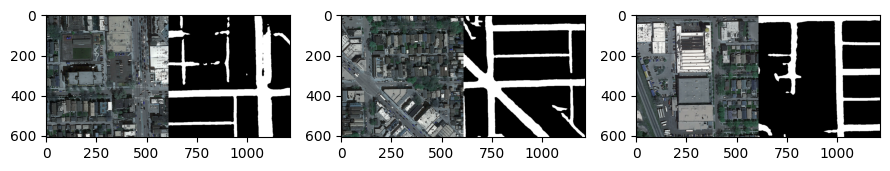

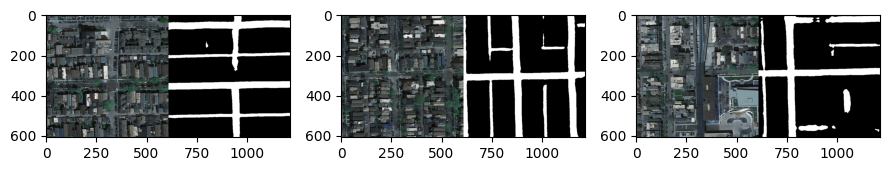

...

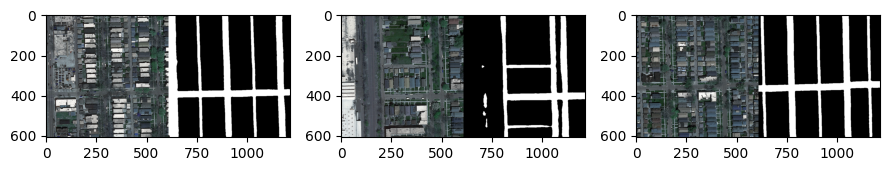

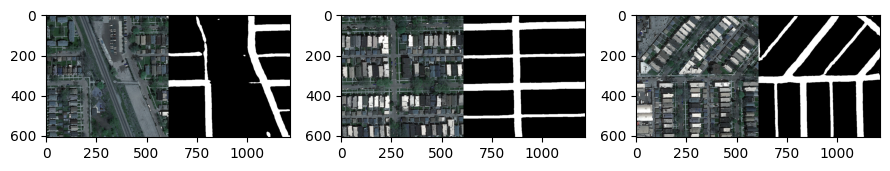

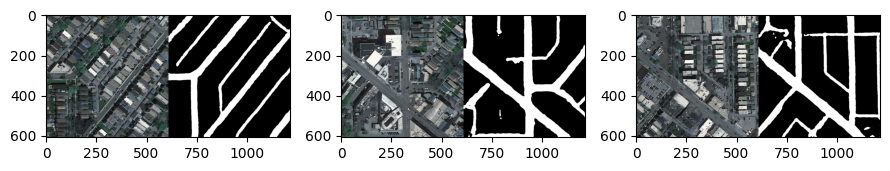

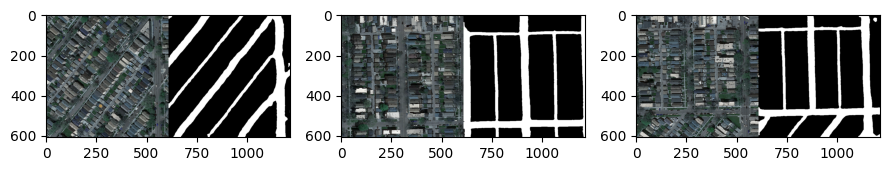

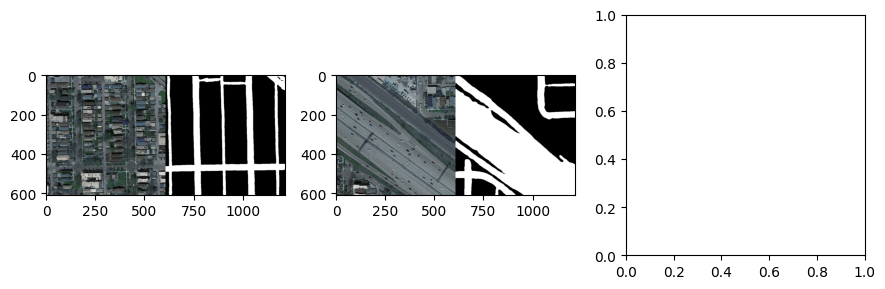

In [55]:
test_directory = "data/test_set_images/"
predicted_test_masks, mask_filenames = test_masks(test_directory, model = deeplab,
                                                  visualize_number=20, deep=True, viz_all=True)

## 2.8

data/test_masks/test_1.png
data/test_masks/test_14.png
data/test_masks/test_19.png
data/test_masks/test_23.png
data/test_masks/test_28.png
data/test_masks/test_32.png
data/test_masks/test_37.png
data/test_masks/test_41.png
data/test_masks/test_46.png
data/test_masks/test_50.png


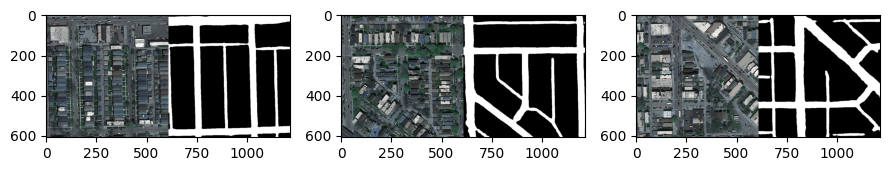

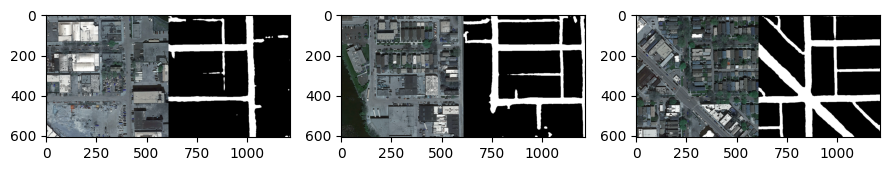

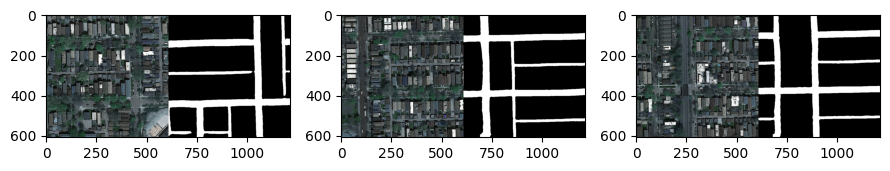

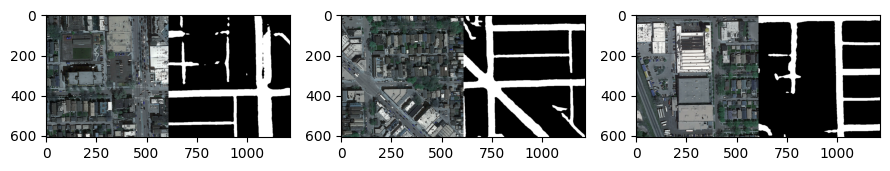

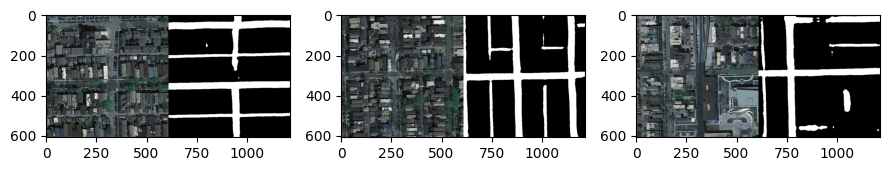

...

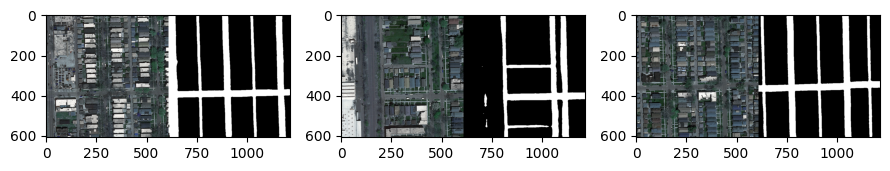

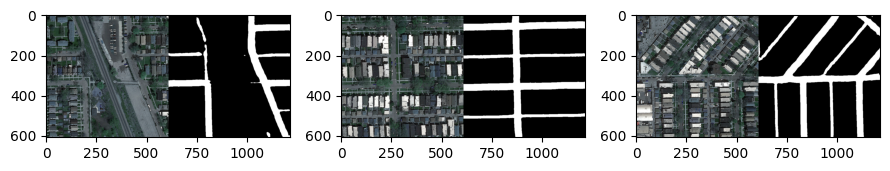

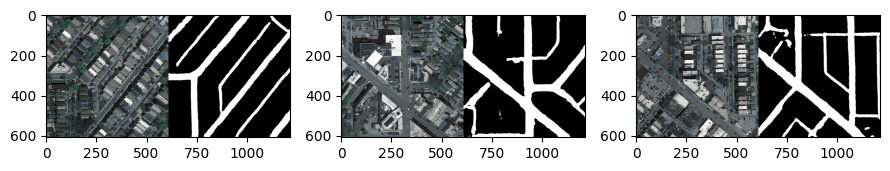

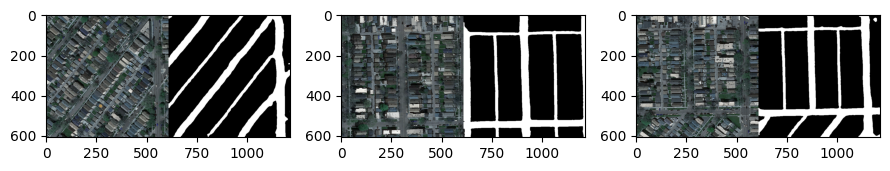

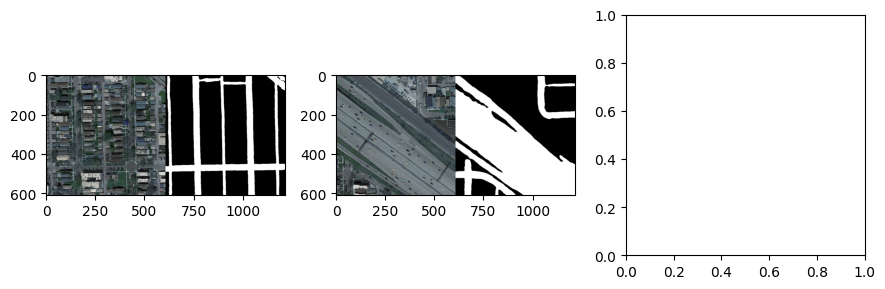

In [59]:
test_directory = "data/test_set_images/"
predicted_test_masks, mask_filenames = test_masks(test_directory, model = deeplab,
                                                  visualize_number=20, deep=True, viz_all=True)

## 2.9

data/test_masks/test_1.png
data/test_masks/test_14.png
data/test_masks/test_19.png
data/test_masks/test_23.png
data/test_masks/test_28.png
data/test_masks/test_32.png
data/test_masks/test_37.png
data/test_masks/test_41.png
data/test_masks/test_46.png
data/test_masks/test_50.png


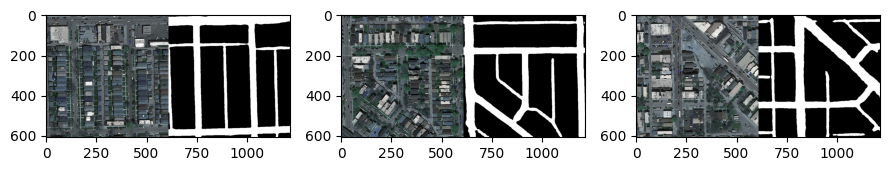

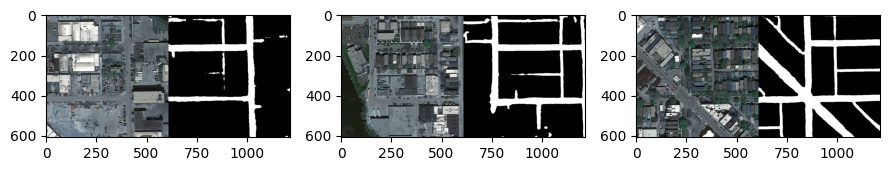

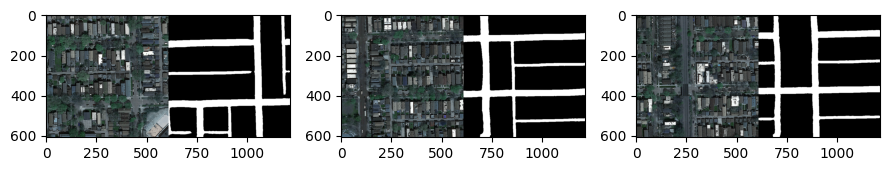

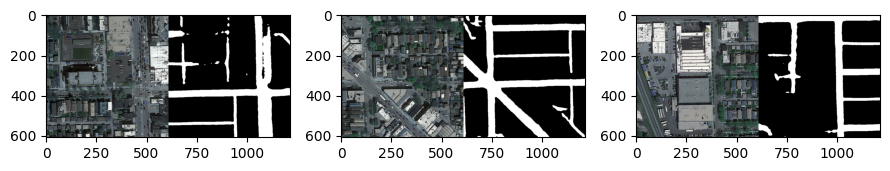

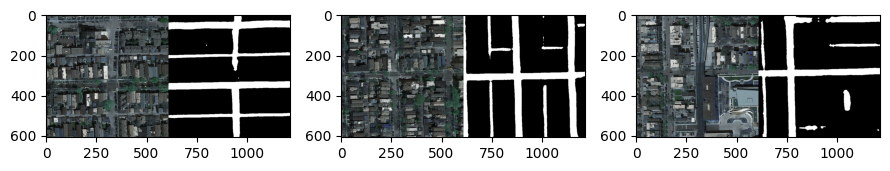

...

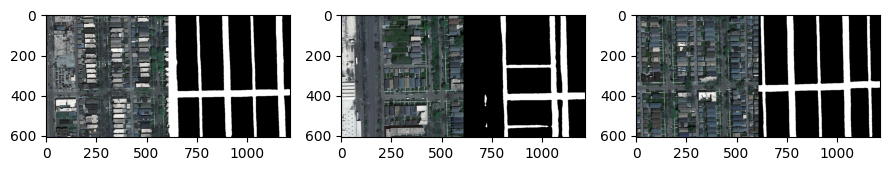

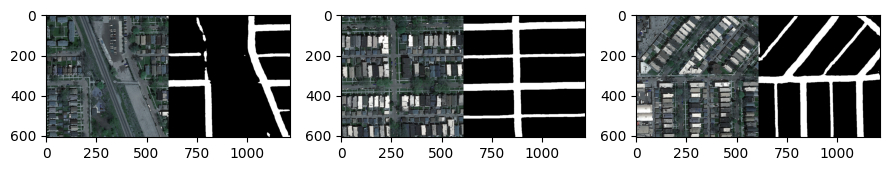

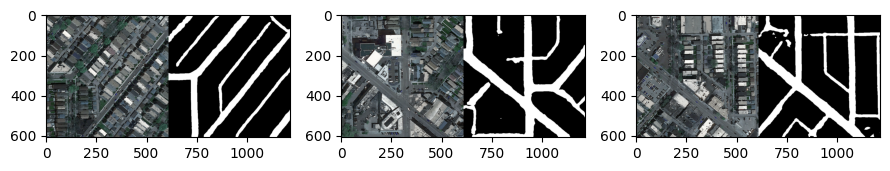

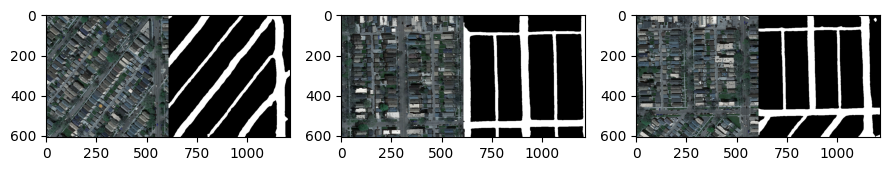

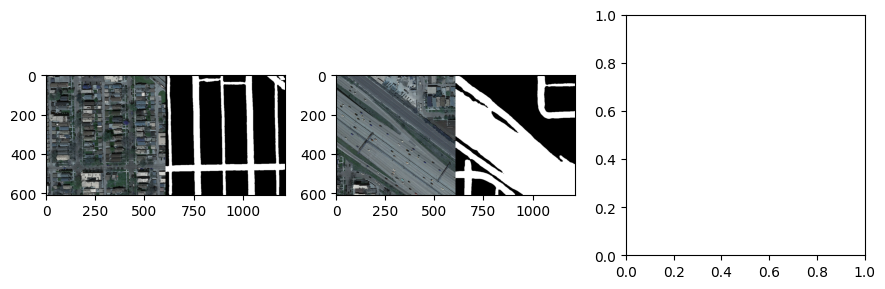

In [61]:
test_directory = "data/test_set_images/"
predicted_test_masks, mask_filenames = test_masks(test_directory, model = deeplab,
                                                  visualize_number=20, deep=True, viz_all=True)

## Save

In [30]:
mask_to_submission.masks_to_submission("submissions/sub_deeplab_.2.csv", *mask_filenames)